# From Pixels to Prognosis: Machine Learning in Tumor Detection


Sinclair Hansen & Lawrence Choraszewski

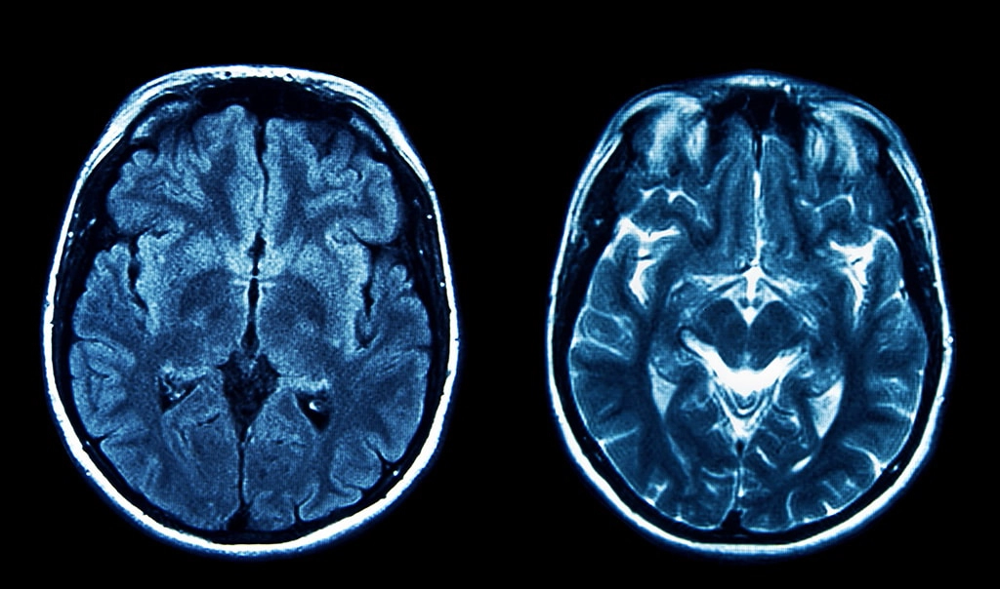
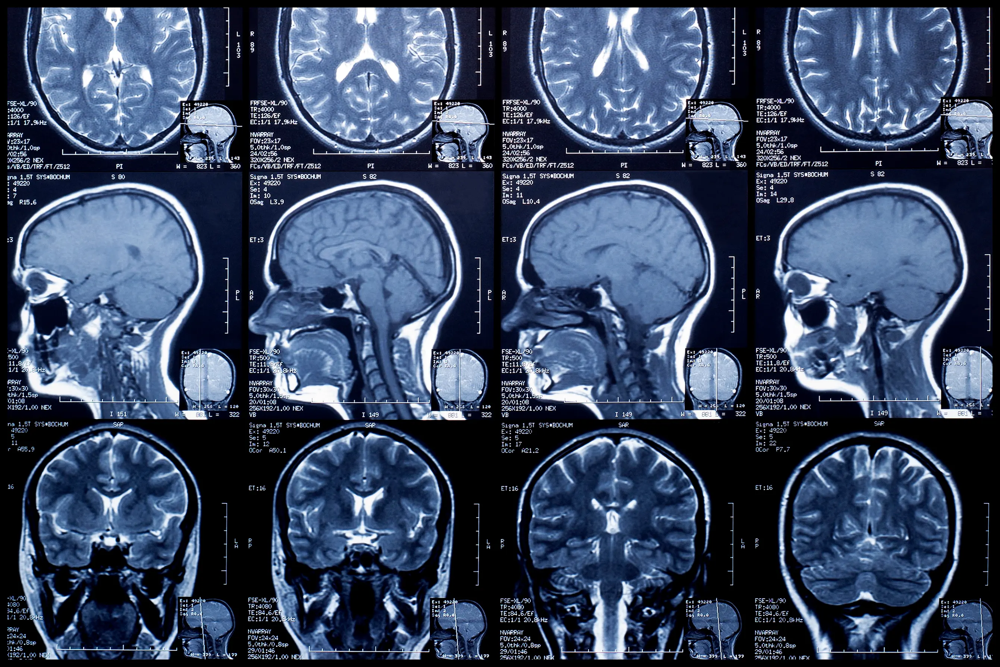
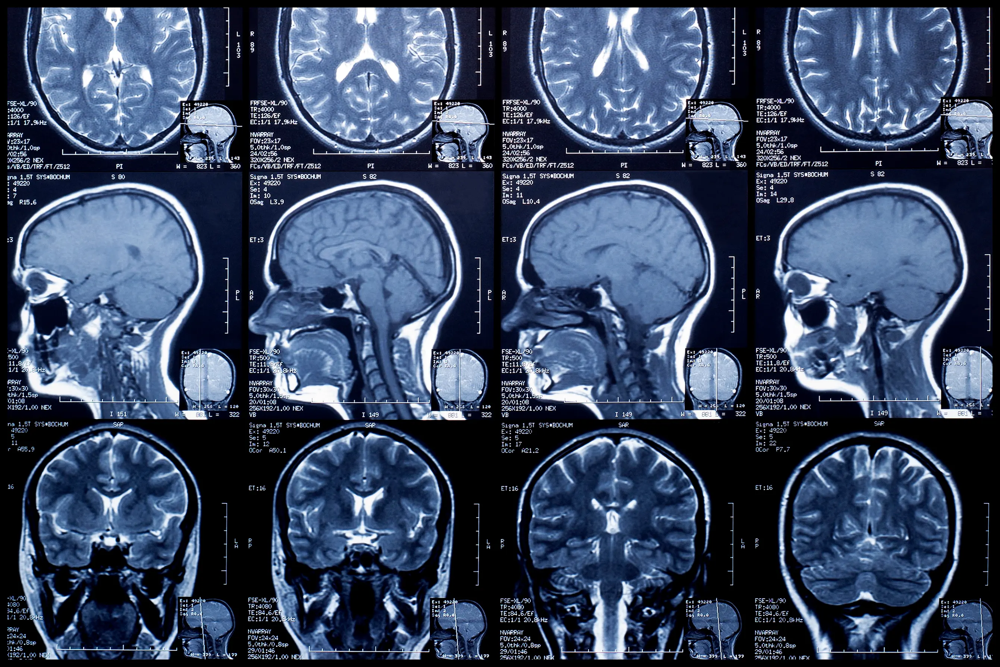
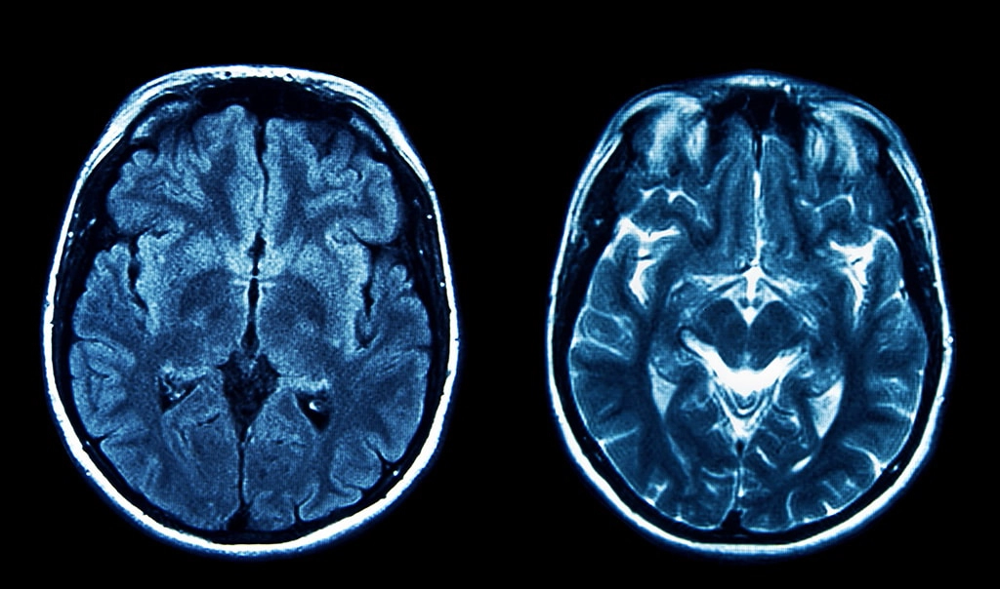

In recent years, Artificial Intelligence (AI) is innovating the medical field by diagnosing diseases earlier, offering personalized treatment to patients, and reducing error in hospitals. This research explores the application of AI in tumor detection through the development of a machine learning-based program capable of identifying different types of tumors in MRI scans. The program is designed to assist doctors in identifying tumors quicker with lower error rates. The program also shows how effortless it is to make a positive impact on our medical care using AI. 

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
import timm

import matplotlib.pyplot as plt # For data viz
import pandas as pd
import numpy as np
import sys
from tqdm.notebook import tqdm

print('System Version:', sys.version)
print('PyTorch version', torch.__version__)
print('Torchvision version', torchvision.__version__)
print('Numpy version', np.__version__)
print('Pandas version', pd.__version__)

System Version: 3.10.14 | packaged by conda-forge | (main, Mar 20 2024, 12:45:18) [GCC 12.3.0]
PyTorch version 2.4.0
Torchvision version 0.19.0
Numpy version 1.26.4
Pandas version 2.2.3


In [2]:
class TumorDataset(Dataset):
    def __init__(self, data_dir, transform=None):
        self.data = ImageFolder(data_dir, transform=transform)
    
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        return self.data[idx]
    
    @property
    def classes(self):
        return self.data.classes

In [3]:
df = TumorDataset(
    data_dir = '/kaggle/input/brain-tumor-mri-dataset/Training'

)

In [4]:
len(df)

5712

In [5]:
data_dir = '/kaggle/input/brain-tumor-mri-dataset/Training'
target_to_class = {v: k for k, v in ImageFolder(data_dir).class_to_idx.items()}
print(target_to_class)

{0: 'glioma', 1: 'meningioma', 2: 'notumor', 3: 'pituitary'}


In [6]:
transform = transforms.Compose([
    transforms.Resize((128,128)),
    transforms.ToTensor(),
    ])
data_dir = '/kaggle/input/brain-tumor-mri-dataset/Training'
dataset = TumorDataset(data_dir, transform)

In [7]:
image, label = dataset[100]
image.shape

torch.Size([3, 128, 128])

In [8]:
#Iterate over dataset
for image, label in dataset:
    break

In [9]:
dataloader = DataLoader(dataset, batch_size=32, shuffle=True)

In [10]:
for images, labels in dataloader:
    break

In [11]:
images.shape, labels.shape

(torch.Size([32, 3, 128, 128]), torch.Size([32]))

In [12]:
class TumorClassifier(nn.Module):
    def __init__(self, num_classes = 53):
        super(TumorClassifier, self).__init__()
        #Where we define all the parts of the model.
        self.base_model = timm.create_model('efficientnet_b0', pretrained=True)
        self.features = nn.Sequential(*list(self.base_model.children())[:-1])

        enet_out_size = 1280
        #Make classifier
        self.classifier = nn.Linear(enet_out_size, num_classes)
        
    def forward(self,x):
        # Connect these parts and return the output
        x = self.features(x)
        output = self.classifier(x)
        return output

In [13]:
model = TumorClassifier(num_classes=53)
print(str(model)[:500])

model.safetensors:   0%|          | 0.00/21.4M [00:00<?, ?B/s]

TumorClassifier(
  (base_model): EfficientNet(
    (conv_stem): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): BatchNormAct2d(
      32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True
      (drop): Identity()
      (act): SiLU(inplace=True)
    )
    (blocks): Sequential(
      (0): Sequential(
        (0): DepthwiseSeparableConv(
          (conv_dw): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)



In [14]:
example_out=model(images)
example_out.shape

torch.Size([32, 53])

In [15]:
#Loss function
criterion = nn.CrossEntropyLoss()
#optimizer
optimizer = optim.Adam(model.parameters(), lr=0.001)


In [16]:
criterion(example_out, labels)
print(example_out.shape, labels.shape)

torch.Size([32, 53]) torch.Size([32])


In [17]:
transform = transforms.Compose([
    transforms.Resize((128,128)),
    transforms.ToTensor(),
])
train_folder = '/kaggle/input/brain-tumor-mri-dataset/Training'
test_folder = '/kaggle/input/brain-tumor-mri-dataset/Testing'

train_dataset = TumorDataset(train_folder, transform =transform)
test_dataset = TumorDataset(test_folder, transform =transform)

train_loader = DataLoader(train_dataset, batch_size=32,shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32,shuffle=False)



In [18]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


In [19]:
# Simple training loop
num_epochs = 5
train_losses, val_losses = [], []


model = TumorClassifier(num_classes=4)
model.to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

for epoch in range(num_epochs):
    # Training phase
    model.train()
    running_loss = 0.0
    for images, labels in tqdm(train_loader, desc='Training loop'):
        # Move inputs and labels to the device
        images, labels = images.to(device), labels.to(device)
        
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item() * labels.size(0)
    train_loss = running_loss / len(train_loader.dataset)
    train_losses.append(train_loss)

Training loop:   0%|          | 0/179 [00:00<?, ?it/s]

Training loop:   0%|          | 0/179 [00:00<?, ?it/s]

Training loop:   0%|          | 0/179 [00:00<?, ?it/s]

Training loop:   0%|          | 0/179 [00:00<?, ?it/s]

Training loop:   0%|          | 0/179 [00:00<?, ?it/s]

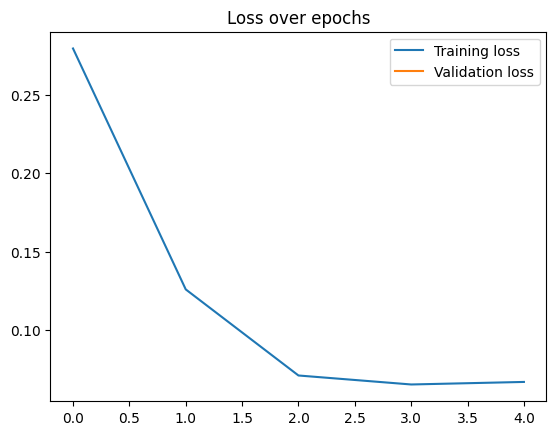

In [20]:
#Visualize
plt.plot(train_losses,label='Training loss')
plt.plot(val_losses,label='Validation loss')
plt.legend()
plt.title("Loss over epochs")
plt.show()

# Testing New MRI Images
**What does confidence look like?**

The graphs below show the models predictions of type of tumor in the MRI scan. The blue bars represent the certainty the model has for that particular type.

**This image shows an uncertain prediction**

The model is indicating that the tumor is most likely a meningioma, but it is potentially a glioma. The tumor is actually a glioma, and this would be an example of a doctor needing to check the prediction prior to proceeding with it. 

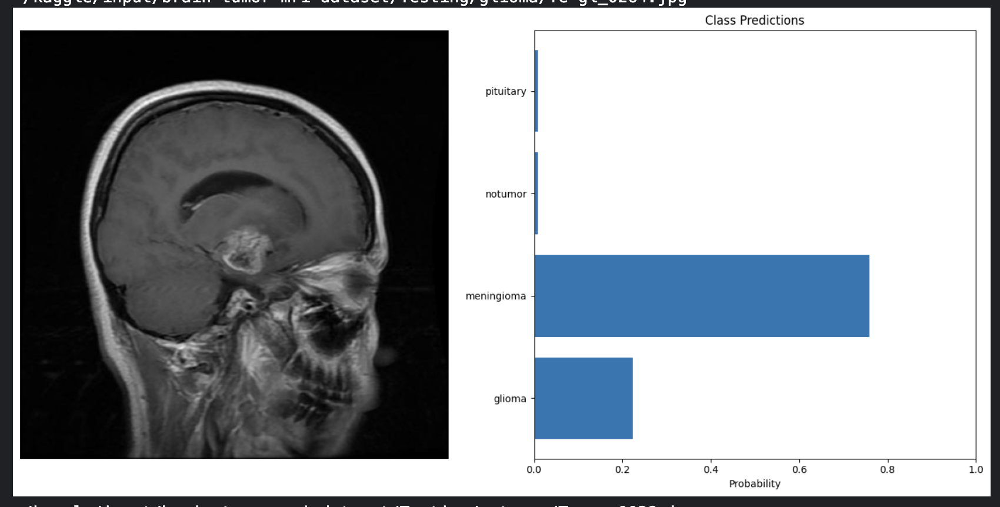


**This is what a certain prediction looks like**

This shows a prediction with high certainty of a particular type of tumor. This is shown through the bar being on only one type. 

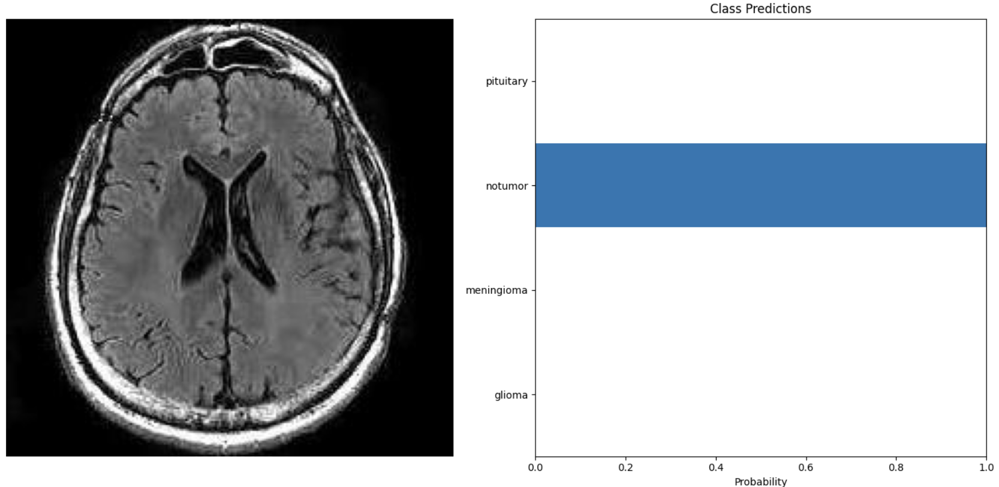

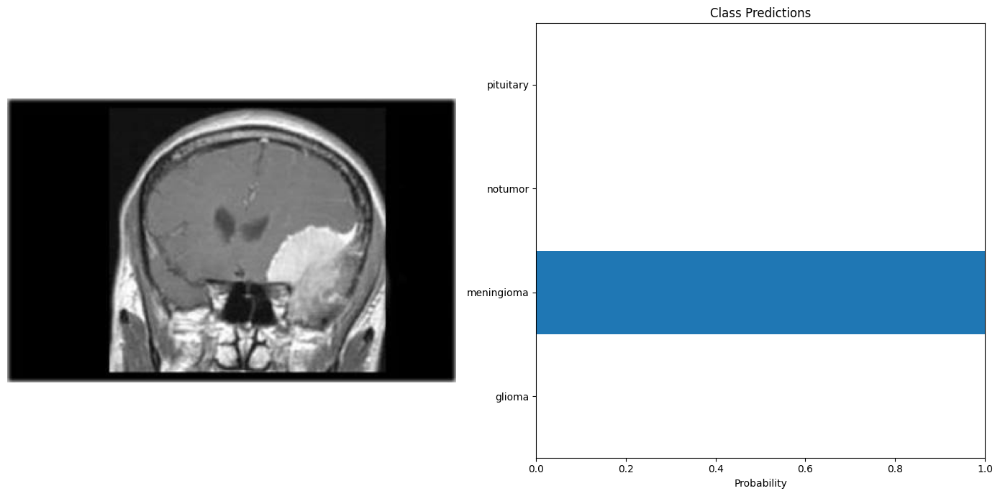

In [21]:
import torch
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

# Load and preprocess the image
def preprocess_image(image_path, transform):
    image = Image.open(image_path).convert("RGB")
    return image, transform(image).unsqueeze(0)

# Predict using the model
def predict(model, image_tensor, device):
    model.eval()
    with torch.no_grad():
        image_tensor = image_tensor.to(device)
        outputs = model(image_tensor)
        probabilities = torch.nn.functional.softmax(outputs, dim=1)
    return probabilities.cpu().numpy().flatten()

# Visualization
def visualize_predictions(original_image, probabilities, class_names):
    fig, axarr = plt.subplots(1, 2, figsize=(14, 7))
    
    # Display image
    axarr[0].imshow(original_image)
    axarr[0].axis("off")
    
    # Display predictions
    axarr[1].barh(class_names, probabilities)
    axarr[1].set_xlabel("Probability")
    axarr[1].set_title("Class Predictions")
    axarr[1].set_xlim(0, 1)

    plt.tight_layout()
    plt.show()

# Example usage
test_image = "/kaggle/input/brain-tumor-mri-dataset/Testing/meningioma/Te-meTr_0000.jpg"
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor()
])

original_image, image_tensor = preprocess_image(test_image, transform)
probabilities = predict(model, image_tensor, device)

# Assuming dataset.classes gives the class names
class_names = dataset.classes 
visualize_predictions(original_image, probabilities, class_names)

/kaggle/input/brain-tumor-mri-dataset/Testing/glioma/Te-gl_0109.jpg


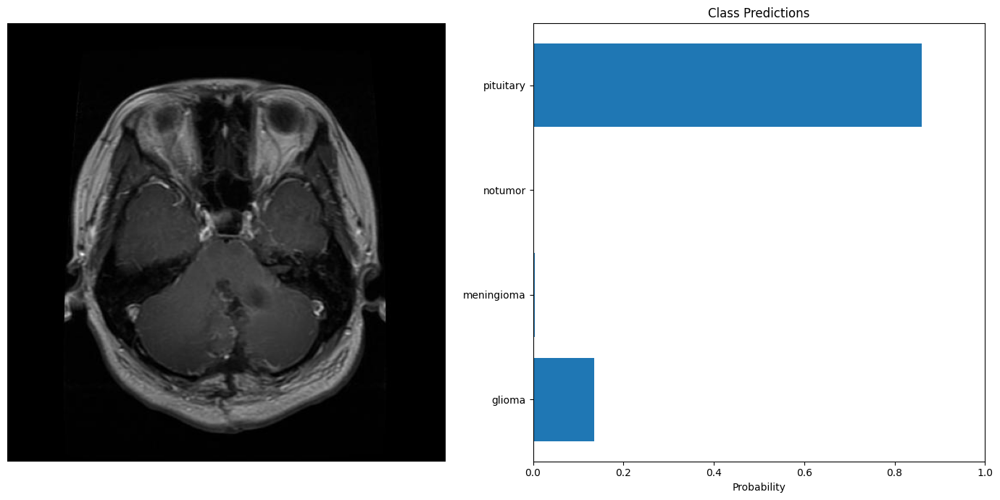

/kaggle/input/brain-tumor-mri-dataset/Testing/pituitary/Te-pi_0164.jpg


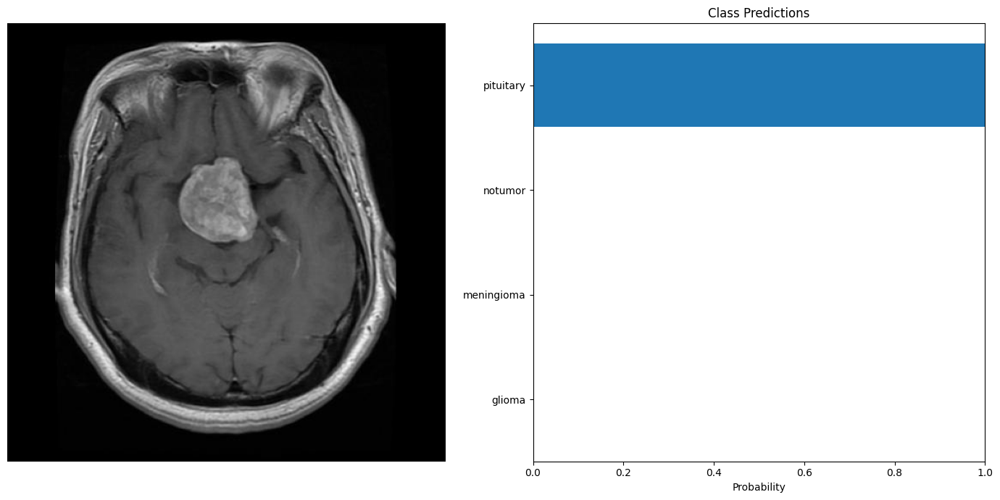

/kaggle/input/brain-tumor-mri-dataset/Testing/pituitary/Te-pi_0061.jpg


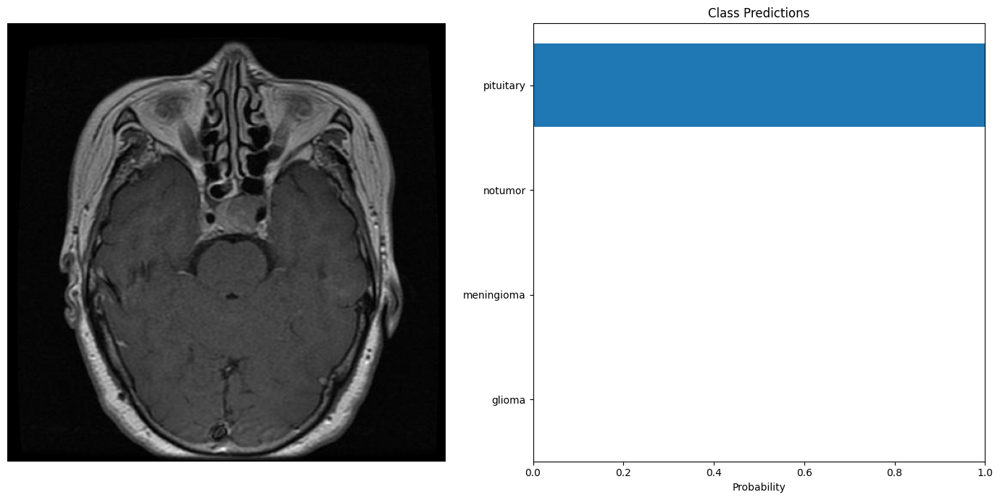

/kaggle/input/brain-tumor-mri-dataset/Testing/glioma/Te-gl_0011.jpg


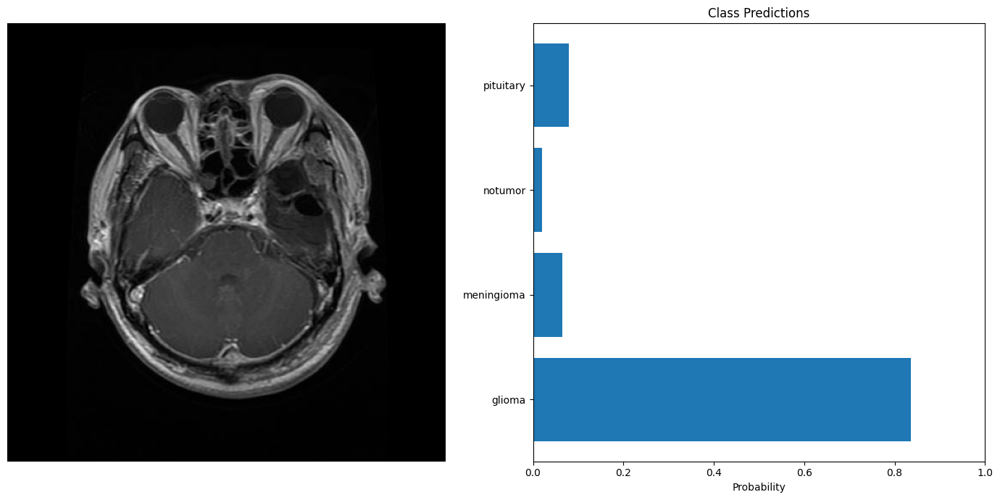

/kaggle/input/brain-tumor-mri-dataset/Testing/meningioma/Te-meTr_0000.jpg


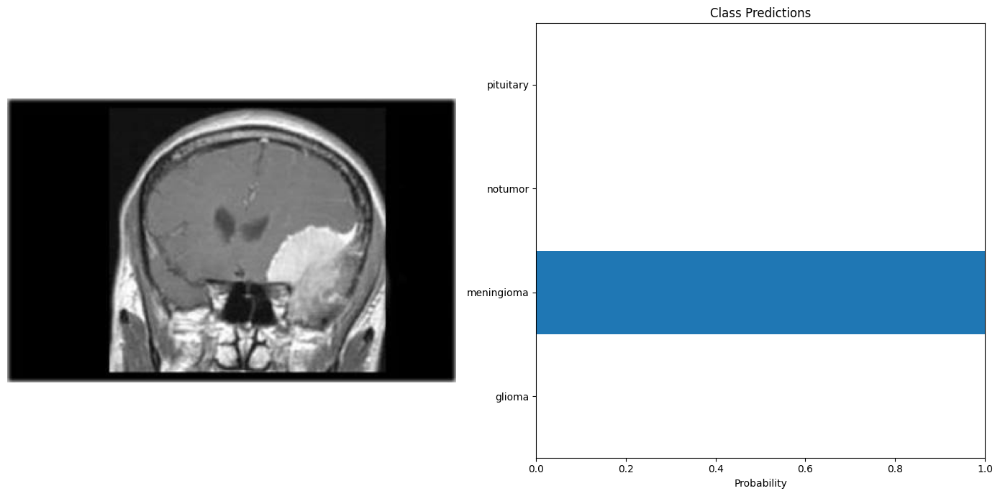

/kaggle/input/brain-tumor-mri-dataset/Testing/notumor/Te-no_0047.jpg


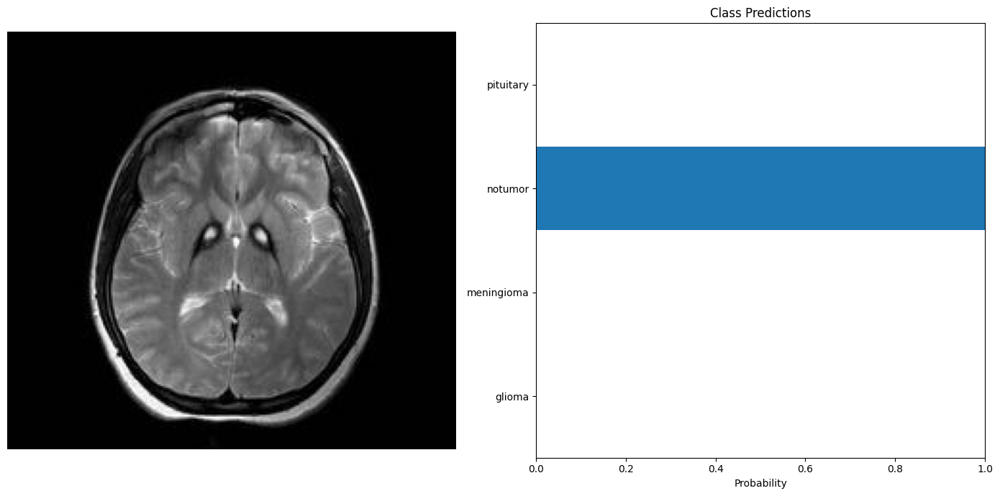

/kaggle/input/brain-tumor-mri-dataset/Testing/notumor/Te-no_0193.jpg


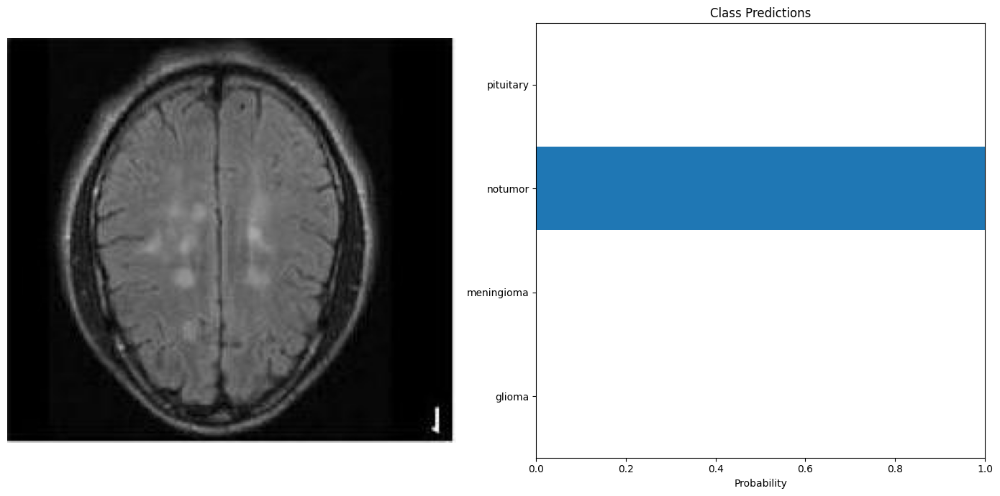

/kaggle/input/brain-tumor-mri-dataset/Testing/notumor/Te-no_0027.jpg


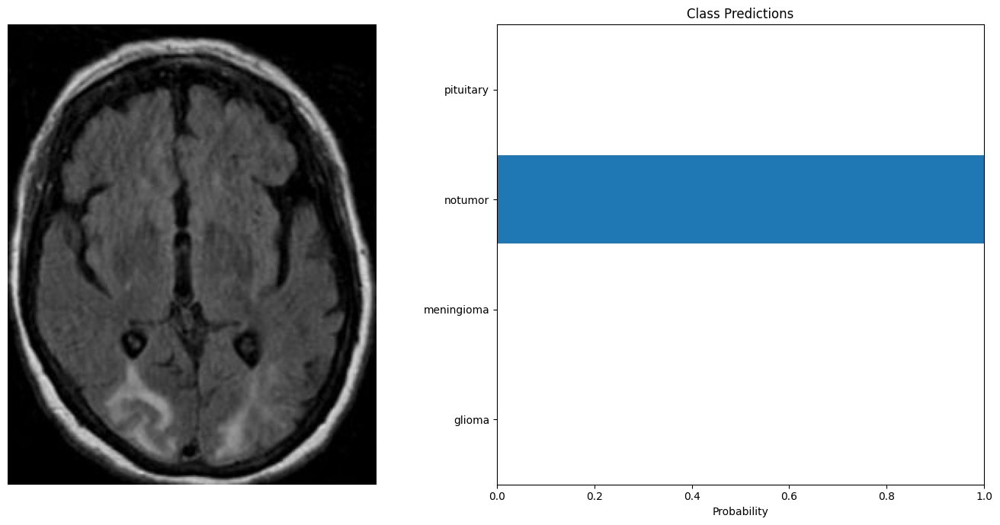

/kaggle/input/brain-tumor-mri-dataset/Testing/notumor/Te-no_0173.jpg


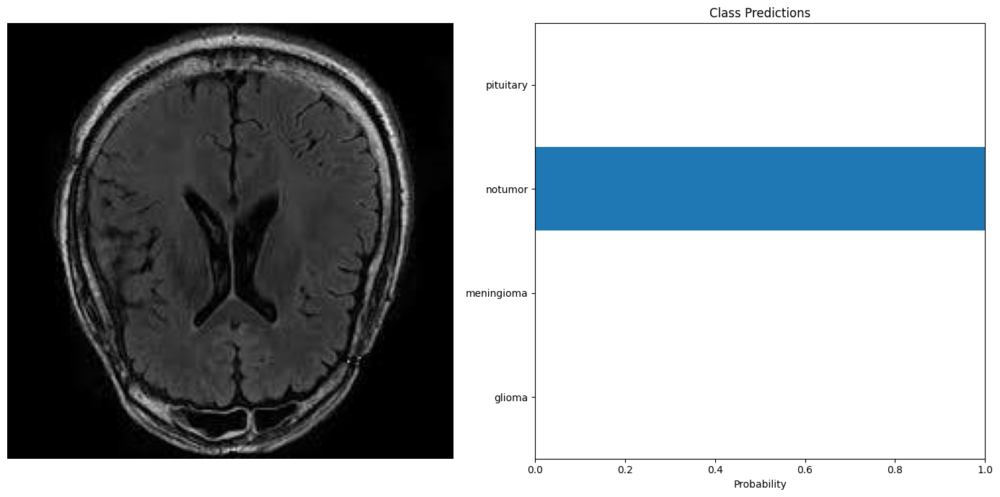

/kaggle/input/brain-tumor-mri-dataset/Testing/meningioma/Te-me_0039.jpg


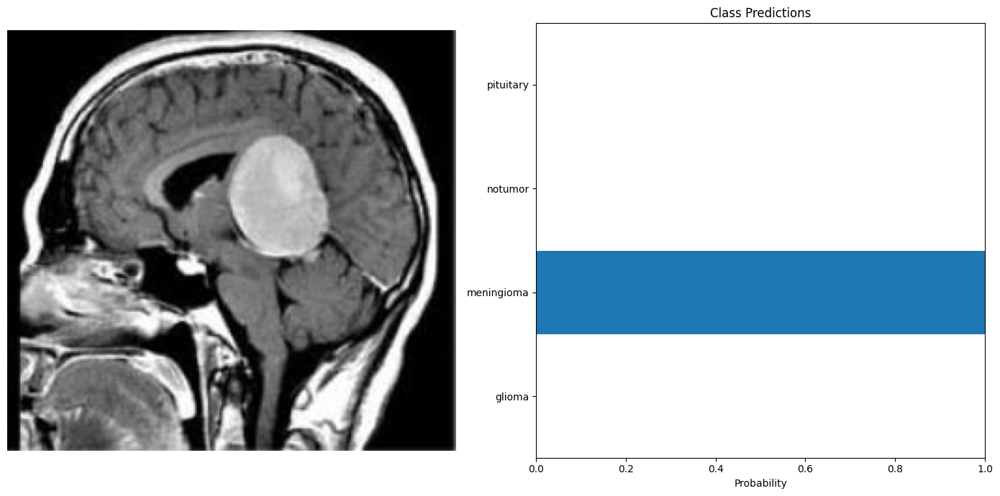

In [22]:
from glob import glob
test_images = glob('/kaggle/input/brain-tumor-mri-dataset/Testing/*/*')
test_examples = np.random.choice(test_images, 10)

for example in test_examples:
    original_image, image_tensor = preprocess_image(example, transform)
    probabilities = predict(model, image_tensor, device)
    print(example)

    # Assuming dataset.classes gives the class names
    class_names = dataset.classes 
    visualize_predictions(original_image, probabilities, class_names)

# Testing Uploaded MRI Scans

The goal for this program is to allow people to upload their MRI scans for the model to make predictions. This section tests MRI scans from various web sources. It helps highlight the difficulties AI has when viewing new images outside of the training and testing set.

**No Tumor MRI Scan Test**

This image comes from Ken Hub and shows a normal MRI scan. The model accurately predicts the lack of tumor in the image. 

Link to article: https://www.kenhub.com/en/library/anatomy/normal-brain-mri

/kaggle/input/notumormriscan/ff.jpg


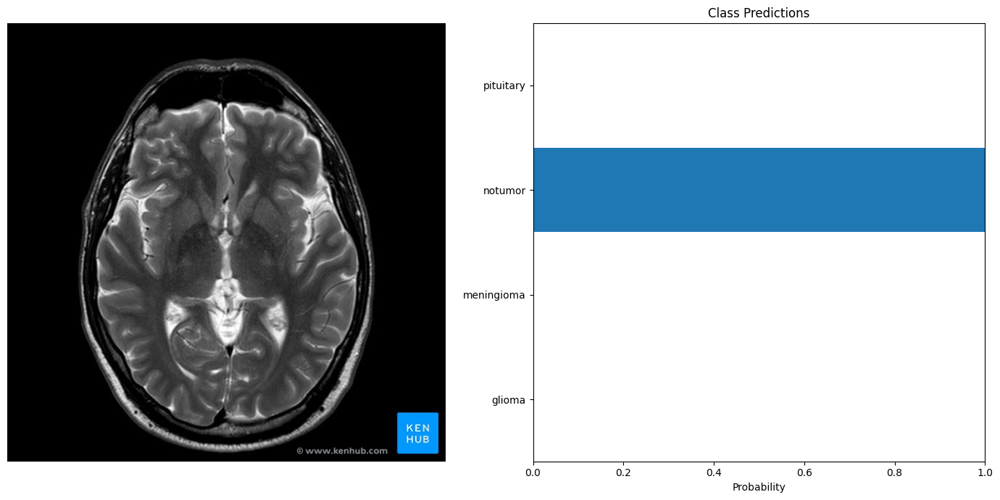

In [23]:
from glob import glob
test_images = glob('/kaggle/input/notumormriscan/ff.jpg')

for example in test_images:
    original_image, image_tensor = preprocess_image(example, transform)
    probabilities = predict(model, image_tensor, device)
    print(example)

    # Assuming dataset.classes gives the class names
    class_names = dataset.classes 
    visualize_predictions(original_image, probabilities, class_names)

**Glioma Imaging Test**

This test is for a glioma tumor, from the article "Moving Toward “Virtual Biopsy” of Gliomas Using Artificial Intelligence." Although the tumor is glioma, the model has high probability of no tumor. This shows the difficulty of training these models when dealing with images outside the training/testing pool. 




Source: https://www.brighamhealthonamission.org/2018/12/18/moving-toward-virtual-biopsy-of-gliomas-using-artificial-intelligence/

/kaggle/input/gliomamritest/Arnaout_Image-768x910.png


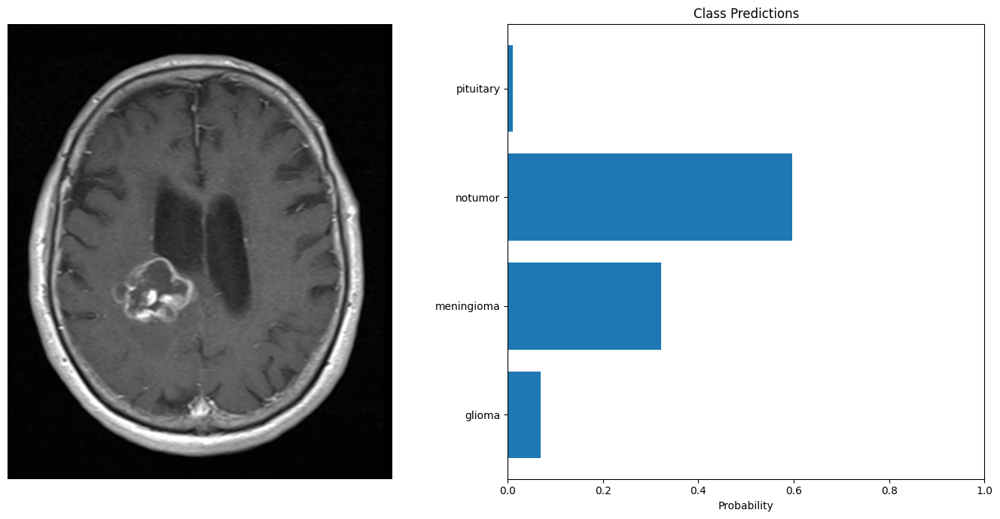

In [24]:
from glob import glob
test_images = glob('/kaggle/input/gliomamritest/Arnaout_Image-768x910.png')

for example in test_images:
    original_image, image_tensor = preprocess_image(example, transform)
    probabilities = predict(model, image_tensor, device)
    print(example)

    # Assuming dataset.classes gives the class names
    class_names = dataset.classes 
    visualize_predictions(original_image, probabilities, class_names)

****

**Meningioma MRI Scan Test**

The image provided below is a meningioma tumor from Radiopaedia. The model has a moderately-high certainty of the tumor being meningioma, but has some chance of being no tumor or glioma. 

Source: https://radiopaedia.org/articles/meningioma

/kaggle/input/meningiomatestmri/dd86e8296503e5713851c6908df2bd_big_gallery.jpg


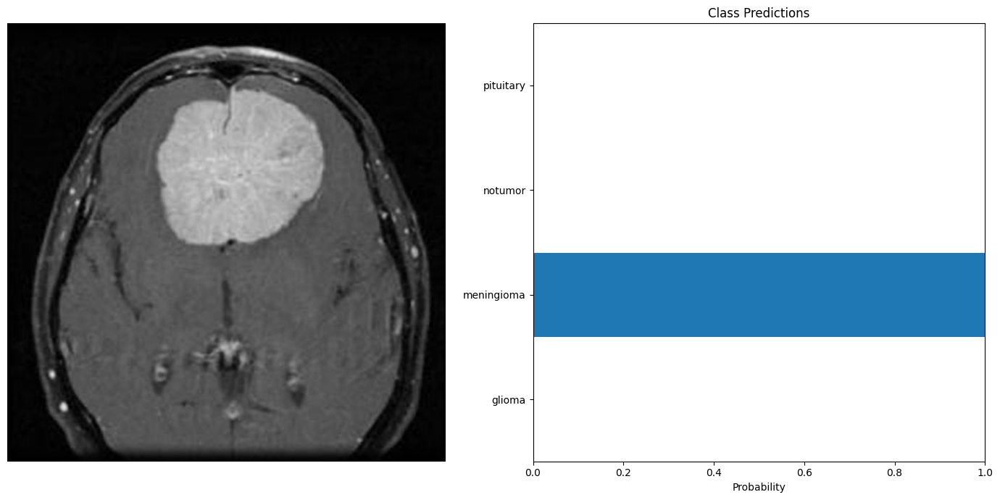

In [25]:
from glob import glob
test_images = glob('/kaggle/input/meningiomatestmri/dd86e8296503e5713851c6908df2bd_big_gallery.jpg')

for example in test_images:
    original_image, image_tensor = preprocess_image(example, transform)
    probabilities = predict(model, image_tensor, device)
    print(example)

    # Assuming dataset.classes gives the class names
    class_names = dataset.classes 
    visualize_predictions(original_image, probabilities, class_names)

**Pituitary Tumor Test**

This image comes from the study Radiology of the Pituitary which analyzed pituitary tumor MRI scans. Although this tumor is pituitary, the model predicts no tumor with a moderate certainty. This highlights the issues of using images outside of the training/testing datasets. 

Link: https://www.ncbi.nlm.nih.gov/books/NBK279161/

/kaggle/input/pituitarymritest/PitTumorTest.jpg


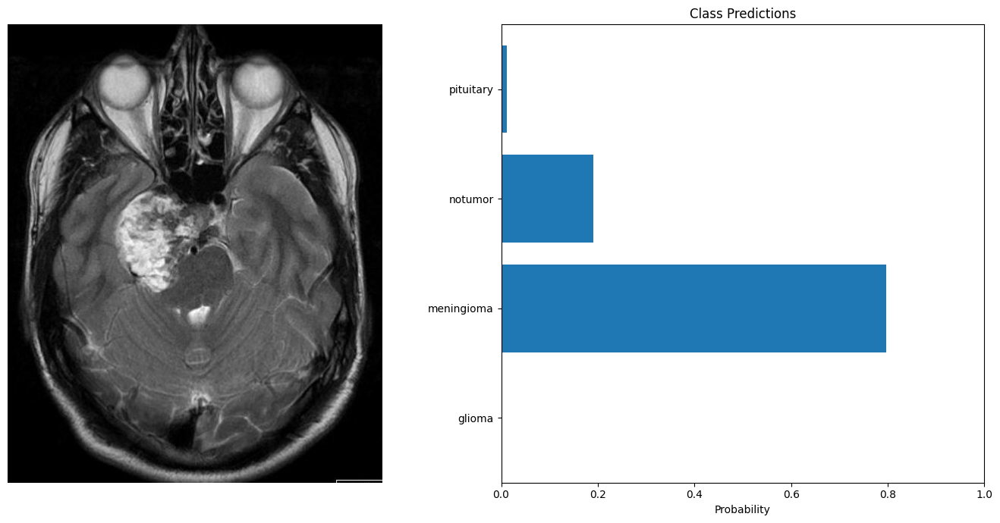

In [26]:
from glob import glob
test_images = glob('/kaggle/input/pituitarymritest/PitTumorTest.jpg')

for example in test_images:
    original_image, image_tensor = preprocess_image(example, transform)
    probabilities = predict(model, image_tensor, device)
    print(example)

    # Assuming dataset.classes gives the class names
    class_names = dataset.classes 
    visualize_predictions(original_image, probabilities, class_names)

# Why does AI have difficulty reading some images?

When looking at images uploaded from outside sources, it is evident that the model has difficulty reading some of the scans. Many of the scans that were correct had lower certainty levels. 

In the book "Artificial Intelligence: A Guide for Thinking Humans" by Dr. Melanie Mitchell, she discusses this issue through a model named AlexNet. In 2012, this program was the best AI for image classification, winning the ImageNet challenge. It blew away the competition with an accuracy rate of 85%. 

After the competition finished, researchers studied the way AlexNet deciphered images. They realized that if images were distorted slightly, to the extent of being noticeable to humans, AlexNet could no longer identify the image properly. This issue was not unique to AlexNet, many competitors in the ImageNet competition were susceptible to having difficulties identifying images outside of the training dataset.

The model in this program is a small scale version of programs like AlexNet. When being trained, it relies on the consistency of the dataset. This is why the predictions on images from the initial dataset have high accuracy. The accuracy decreases significantly when pulling images from outside sources due to there potentially being differences in the images that we as humans cannot see. 